# 1. IMPORTS & CONFIGURATIONS

## 1.1 IMPORTS

In [1]:
# Evaluate new
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

#torch imports
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from timm.layers import DropPath, to_2tuple, trunc_normal_
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader
from torchsummary import summary
from torch.utils.data import Dataset
import torchvision.transforms.functional as TF
import torch.nn.functional as F


#other imports
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt
import random
from tqdm import tqdm
import multiprocessing as mp
import os
import numpy as np
import time
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
import gc
from collections.abc import Callable

## 1.2 CONFIGURATIONS

In [2]:
# paths
RAIN100H_PATH = "/kaggle/input/rain-dataset/heavy-20251105T081926Z-1-001/heavy"
RAIN100L_PATH = "/kaggle/input/rain-dataset/light-20251105T081926Z-1-001/light"
RAIN14000_PATH = "/kaggle/input/rain14000"
TEST100_PATH = "/kaggle/input/rain-dataset/Test100/Test100"
TEST1200_PATH = "/kaggle/input/rain-dataset/Test1200/Test1200"
TEST2800_PATH = "/kaggle/input/rain-dataset/Test2800/Test2800"

CHECKPOINT_PATH = "/kaggle/input/cs406-new/pytorch/default/1/best_model_new.pt"

# data
# Rain14000 - Rain100H - Rain100L - Test100 - Test1200 - Test2800 - Nature - TimeTest

# model
DIM=96
L_RNN=3
N_RTB=6
WINDOW_SIZE = 7
NUM_HEADS = 2
PATCH_SIZE = 1  

# linh tinh
NUM_PROC = mp.cpu_count()
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
plt.rcParams['figure.figsize'] = (16, 9)

In [3]:
print(DEVICE)

cuda


# 2. DATA PREPARATION

## 2.1 Utils

In [4]:
class RainDataset(Dataset):
    def __init__(self, dataset_name, data_path, image_size=56, mode='train'):
        self.dataset_name = dataset_name
        self.mode = mode
        self.image_size = image_size
        
        # 1. Định nghĩa cấu trúc folder tập trung
        configs = {
            'Rain14000': {'in': 'input', 'out': 'output'},
            'Rain100L':  {'in': 'rain',  'out': 'norain'},
            'Rain100H':  {'in': 'rain',  'out': 'norain'},
            'Test100':   {'in': 'input', 'out': 'target'},
            'Test1200':  {'in': 'input', 'out': 'target'},
            'Test2800':  {'in': 'input', 'out': 'target'},
            'Nature':    {'in': '',      'out': ''}, 
            'TimeTest':  {'in': '',      'out': ''}
        }

        if dataset_name not in configs:
            raise ValueError(f"Dataset {dataset_name} không được hỗ trợ!")
        if mode not in ['train', 'val', 'test']:
            raise ValueError(f"{mode} không được hỗ trợ!")
        
        cfg = configs[dataset_name]
        data_path = Path(data_path)

        # 2. Xử lý logic đường dẫn linh hoạt
        if dataset_name in ['Nature', 'TimeTest']:
            self.input_dir = data_path
            self.target_dir = data_path
        elif dataset_name in ['Test100', 'Test1200', 'Test2800']:
            self.input_dir = Path.joinpath(data_path, cfg['in'])
            self.target_dir = Path.joinpath(data_path, cfg['out'])          
        else:
            self.input_dir = Path.joinpath(data_path, mode, cfg['in'])
            self.target_dir = Path.joinpath(data_path, mode, cfg['out'])

        # 3. Lấy danh sách file
        valid_extensions = ('.jpg', '.jpeg', '.png')
        self.file_names = sorted([
            f.name for f in self.input_dir.iterdir() 
            if f.suffix.lower() in valid_extensions
        ])
        print(f"✅ [{mode.upper()}] Đã tải {len(self.file_names)} ảnh từ {dataset_name}")

        self.input_paths = [Path.joinpath(self.input_dir, f) for f in self.file_names]
        self.target_paths = [Path.joinpath(self.target_dir, f) for f in self.file_names]
        
    def __len__(self):
        return len(self.file_names)

    def __getitem__(self, index):        
        # Đọc ảnh
        input_img = Image.open(self.input_paths[index]).convert('RGB')
        target_img = Image.open(self.target_paths[index]).convert('RGB')

        # 4. Logic Xử lý ảnh 
        if self.mode == 'train':
            # Random Crop
            w, h = input_img.size
            th, tw = self.image_size, self.image_size
            
            if w < tw or h < th:
                input_img = TF.resize(input_img, (th, tw))
                target_img = TF.resize(target_img, (th, tw))
                i, j = 0, 0
            else:
                i = random.randint(0, h - th)
                j = random.randint(0, w - tw)
            
            input_img = TF.crop(input_img, i, j, th, tw)
            target_img = TF.crop(target_img, i, j, th, tw)

            # Random Flips
            if random.random() > 0.5:
                input_img = TF.hflip(input_img)
                target_img = TF.hflip(target_img)
            if random.random() > 0.5:
                input_img = TF.vflip(input_img)
                target_img = TF.vflip(target_img)
                
        elif self.mode == 'val':
            input_img = TF.center_crop(input_img, (self.image_size, self.image_size))
            target_img = TF.center_crop(target_img, (self.image_size, self.image_size))
        else:
            pass

        # 5. Chuyển sang Tensor [0, 1]
        input_tensor = TF.to_tensor(input_img)
        target_tensor = TF.to_tensor(target_img)

        return target_tensor, input_tensor

## 2.2 Create Dataloader

In [5]:
# Rain14000 - Rain100H - Rain100L - Test100 - Test1200 - Test2800 - Nature - TimeTest
Rain100H_dataset = RainDataset('Rain100H', RAIN100H_PATH, image_size=None, mode='test')
Rain100L_dataset = RainDataset('Rain100L', RAIN100L_PATH, image_size=None, mode='test')
Rain14000_dataset = RainDataset('Rain14000', RAIN14000_PATH, image_size=None, mode='test')
Test100_dataset = RainDataset('Test100', TEST100_PATH, image_size=None, mode='test')
Test1200_dataset = RainDataset('Test1200', TEST1200_PATH, image_size=None, mode='test')
Test2800_dataset = RainDataset('Test2800', TEST2800_PATH, image_size=None, mode='test')

Rain100H_loader = DataLoader(dataset=Rain100H_dataset, batch_size=1, shuffle=False, pin_memory=False, drop_last=False)
Rain100L_loader = DataLoader(dataset=Rain100L_dataset, batch_size=1, shuffle=False, pin_memory=False, drop_last=False)
Rain14000_loader = DataLoader(dataset=Rain14000_dataset, batch_size=1, shuffle=False, pin_memory=False, drop_last=False)
Test100_loader = DataLoader(dataset=Test100_dataset, batch_size=1, shuffle=False, pin_memory=False, drop_last=False)
Test1200_loader = DataLoader(dataset=Test1200_dataset, batch_size=1, shuffle=False, pin_memory=False, drop_last=False)
Test2800_loader = DataLoader(dataset=Test2800_dataset, batch_size=1, shuffle=False, pin_memory=False, drop_last=False)

✅ [TEST] Đã tải 200 ảnh từ Rain100H
✅ [TEST] Đã tải 200 ảnh từ Rain100L
✅ [TEST] Đã tải 1372 ảnh từ Rain14000
✅ [TEST] Đã tải 98 ảnh từ Test100
✅ [TEST] Đã tải 1200 ảnh từ Test1200
✅ [TEST] Đã tải 2800 ảnh từ Test2800


# 3. Model

## 3.1 Transformer-based

In [6]:
#fully connected multilayer perceptron
class Mlp(nn.Module):
    def __init__(self, in_features, hidden_features=None, out_features=None, act_layer=nn.GELU, drop=0.):
        super().__init__()
        out_features = out_features or in_features
        hidden_features = hidden_features or in_features
        self.fc1 = nn.Linear(in_features, hidden_features)
        self.act = act_layer()
        self.fc2 = nn.Linear(hidden_features, out_features)
        self.drop = nn.Dropout(drop)

    def forward(self, x):
        x = self.fc1(x)
        x = self.act(x)
        x = self.drop(x)
        x = self.fc2(x)
        x = self.drop(x)
        return x


def window_partition(x, window_size):
    """
    Args:
        x: (B, H, W, C)
        window_size (int): window size

    Returns:
        windows: (num_windows*B, window_size, window_size, C)
    """
    B, H, W, C = x.shape
    x = x.view(B, H // window_size, window_size, W // window_size, window_size, C)
    windows = x.permute(0, 1, 3, 2, 4, 5).contiguous().view(-1, window_size, window_size, C)
    return windows


def window_reverse(windows, window_size, H, W):
    """
    Args:
        windows: (num_windows*B, window_size, window_size, C)
        window_size (int): Window size
        H (int): Height of image
        W (int): Width of image

    Returns:
        x: (B, H, W, C)
    """
    B = int(windows.shape[0] / (H * W / window_size / window_size))
    x = windows.view(B, H // window_size, W // window_size, window_size, window_size, -1)
    x = x.permute(0, 1, 3, 2, 4, 5).contiguous().view(B, H, W, -1)
    return x


class WindowAttention(nn.Module):
    r""" Window based multi-head self attention (W-MSA) module with relative position bias.
    It supports both of shifted and non-shifted window.

    Args:
        dim (int): Number of input channels.
        window_size (tuple[int]): The height and width of the window.
        num_heads (int): Number of attention heads.
        qkv_bias (bool, optional):  If True, add a learnable bias to query, key, value. Default: True
        qk_scale (float | None, optional): Override default qk scale of head_dim ** -0.5 if set
        attn_drop (float, optional): Dropout ratio of attention weight. Default: 0.0
        proj_drop (float, optional): Dropout ratio of output. Default: 0.0
    """

    def __init__(self, dim, window_size, num_heads, qkv_bias=True, qk_scale=None, attn_drop=0., proj_drop=0.):

        super().__init__()
        self.dim = dim
        self.window_size = window_size  # Wh, Ww
        self.num_heads = num_heads
        head_dim = dim // num_heads
        self.scale = qk_scale or head_dim ** -0.5

        # define a parameter table of relative position bias
        self.relative_position_bias_table = nn.Parameter(
            torch.zeros((2 * window_size[0] - 1) * (2 * window_size[1] - 1), num_heads))  # 2*Wh-1 * 2*Ww-1, nH

        # get pair-wise relative position index for each token inside the window
        coords_h = torch.arange(self.window_size[0])
        coords_w = torch.arange(self.window_size[1])
        coords = torch.stack(torch.meshgrid([coords_h, coords_w]))  # 2, Wh, Ww
        coords_flatten = torch.flatten(coords, 1)  # 2, Wh*Ww
        relative_coords = coords_flatten[:, :, None] - coords_flatten[:, None, :]  # 2, Wh*Ww, Wh*Ww
        relative_coords = relative_coords.permute(1, 2, 0).contiguous()  # Wh*Ww, Wh*Ww, 2
        relative_coords[:, :, 0] += self.window_size[0] - 1  # shift to start from 0
        relative_coords[:, :, 1] += self.window_size[1] - 1
        relative_coords[:, :, 0] *= 2 * self.window_size[1] - 1
        relative_position_index = relative_coords.sum(-1)  # Wh*Ww, Wh*Ww
        self.register_buffer("relative_position_index", relative_position_index)
        #query, key, value share weights
        self.qkv = nn.Linear(dim, dim * 3, bias=qkv_bias)
        self.attn_drop = nn.Dropout(attn_drop)
        self.proj = nn.Linear(dim, dim)
        self.proj_drop = nn.Dropout(proj_drop)

        trunc_normal_(self.relative_position_bias_table, std=.02)
        self.softmax = nn.Softmax(dim=-1)

    def forward(self, x, mask=None):
        """
        Args:
            x: input features with shape of (num_windows*B, N, C)
            mask: (0/-inf) mask with shape of (num_windows, Wh*Ww, Wh*Ww) or None
        """
        B_, N, C = x.shape
        #divide depths according to the number of heads
        qkv = self.qkv(x).reshape(B_, N, 3, self.num_heads, C // self.num_heads).permute(2, 0, 3, 1, 4)
        q, k, v = qkv[0], qkv[1], qkv[2]  # make torchscript happy (cannot use tensor as tuple)
        #attention score is calculated by taking the dot product between query and key
        q = q * self.scale
        attn = (q @ k.transpose(-2, -1))
        #add relative position bias into the attention score
        relative_position_bias = self.relative_position_bias_table[self.relative_position_index.view(-1)].view(
            self.window_size[0] * self.window_size[1], self.window_size[0] * self.window_size[1], -1)  # Wh*Ww,Wh*Ww,nH
        relative_position_bias = relative_position_bias.permute(2, 0, 1).contiguous()  # nH, Wh*Ww, Wh*Ww
        attn = attn + relative_position_bias.unsqueeze(0)
        #calculate a softmax version of the attention scores
        if mask is not None:
            nW = mask.shape[0]
            attn = attn.view(B_ // nW, nW, self.num_heads, N, N) + mask.unsqueeze(1).unsqueeze(0)
            attn = attn.view(-1, self.num_heads, N, N)
            attn = self.softmax(attn)
        else:
            attn = self.softmax(attn)

        attn = self.attn_drop(attn)
        #multiply attention with value and project x
        x = (attn @ v).transpose(1, 2).reshape(B_, N, C)
        x = self.proj(x)
        x = self.proj_drop(x)
        return x

    def extra_repr(self) -> str:
        return f'dim={self.dim}, window_size={self.window_size}, num_heads={self.num_heads}'

    def flops(self, N):
        # calculate flops for 1 window with token length of N
        flops = 0
        # qkv = self.qkv(x)
        flops += N * self.dim * 3 * self.dim
        # attn = (q @ k.transpose(-2, -1))
        flops += self.num_heads * N * (self.dim // self.num_heads) * N
        #  x = (attn @ v)
        flops += self.num_heads * N * N * (self.dim // self.num_heads)
        # x = self.proj(x)
        flops += N * self.dim * self.dim
        return flops

In [7]:
class TransformerBlock(nn.Module):
    r""" Swin Transformer Block.

    Args:
        dim (int): Number of input channels.
        input_resolution (tuple[int]): Input resulotion (H,W).
        num_heads (int): Number of attention heads.
        window_size (int): Window size.
        shift_size (int): Shift size for SW-MSA.
        mlp_ratio (float): Ratio of mlp hidden dim to embedding dim.
        qkv_bias (bool, optional): If True, add a learnable bias to query, key, value. Default: True
        qk_scale (float | None, optional): Override default qk scale of head_dim ** -0.5 if set.
        drop (float, optional): Dropout rate. Default: 0.0
        attn_drop (float, optional): Attention dropout rate. Default: 0.0
        drop_path (float, optional): Stochastic depth rate. Default: 0.0
        act_layer (nn.Module, optional): Activation layer. Default: nn.GELU
        norm_layer (nn.Module, optional): Normalization layer.  Default: nn.LayerNorm
    """

    def __init__(self, dim, input_resolution, num_heads, window_size=7, shift_size=0,
                 mlp_ratio=1., qkv_bias=True, qk_scale=None, drop=0., attn_drop=0., drop_path=0.,
                 act_layer=nn.GELU, norm_layer=nn.LayerNorm):
        super().__init__()
        self.dim = dim
        self.input_resolution = input_resolution
        self.num_heads = num_heads
        self.window_size = window_size
        self.shift_size = shift_size
        self.mlp_ratio = mlp_ratio
        if min(self.input_resolution) <= self.window_size:
            # if window size is larger than input resolution, we don't partition windows
            self.shift_size = 0
            self.window_size = min(self.input_resolution)
        assert 0 <= self.shift_size < self.window_size, "shift_size must in 0-window_size"

        self.norm1 = norm_layer(dim)
        self.attn = WindowAttention(
            dim, window_size=to_2tuple(self.window_size), num_heads=num_heads,
            qkv_bias=qkv_bias, qk_scale=qk_scale, attn_drop=attn_drop, proj_drop=drop)

        self.drop_path = DropPath(drop_path) if drop_path > 0. else nn.Identity()
        self.norm2 = norm_layer(dim)
        mlp_hidden_dim = int(dim * mlp_ratio)
        H, W = self.input_resolution
        self.mlp = Mlp(in_features=dim, hidden_features=mlp_hidden_dim, act_layer=act_layer, drop=drop)

        if self.shift_size > 0:
            # calculate attention mask for SW-MSA
            img_mask = torch.zeros((1, H, W, 1))  # 1 H W 1
            h_slices = (slice(0, -self.window_size),
                        slice(-self.window_size, -self.shift_size),
                        slice(-self.shift_size, None))
            w_slices = (slice(0, -self.window_size),
                        slice(-self.window_size, -self.shift_size),
                        slice(-self.shift_size, None))
            cnt = 0
            for h in h_slices:
                for w in w_slices:
                    img_mask[:, h, w, :] = cnt
                    cnt += 1

            mask_windows = window_partition(img_mask, self.window_size)  # nW, window_size, window_size, 1
            mask_windows = mask_windows.view(-1, self.window_size * self.window_size)
            attn_mask = mask_windows.unsqueeze(1) - mask_windows.unsqueeze(2)
            attn_mask = attn_mask.masked_fill(attn_mask != 0, float(-100.0)).masked_fill(attn_mask == 0, float(0.0))
        else:
            attn_mask = None

        self.register_buffer("attn_mask", attn_mask)


    def forward(self, x):
        #print("transformer: " + str(torch.cuda.memory_allocated(0)))
        #print(f"Calculating attion. Input size: {x.shape}")
        H, W = self.input_resolution
        B, L, C = x.shape
        assert L == H * W, "input feature has wrong size"

        shortcut = x
        x = self.norm1(x)
        x = x.view(B, H, W, C)

        # cyclic shift
        if self.shift_size > 0:
            shifted_x = torch.roll(x, shifts=(-self.shift_size, -self.shift_size), dims=(1, 2))
        else:
            shifted_x = x

        # partition windows
        x_windows = window_partition(shifted_x, self.window_size)  # nW*B, window_size, window_size, C
        x_windows = x_windows.view(-1, self.window_size * self.window_size, C)  # nW*B, window_size*window_size, C

        # W-MSA/SW-MSA
        attn_windows = self.attn(x_windows, mask=self.attn_mask)  # nW*B, window_size*window_size, C

        # merge windows
        attn_windows = attn_windows.view(-1, self.window_size, self.window_size, C)
        shifted_x = window_reverse(attn_windows, self.window_size, H, W)  # B H' W' C

        # reverse cyclic shift
        if self.shift_size > 0:
            x = torch.roll(shifted_x, shifts=(self.shift_size, self.shift_size), dims=(1, 2))
        else:
            x = shifted_x

        x = x.view(B, H * W, C) #B L C
        # FFN
        x = shortcut + self.drop_path(x)
        x = x + self.drop_path(self.mlp(self.norm2(x)))

        return x

    def extra_repr(self) -> str:
        return f"dim={self.dim}, input_resolution={self.input_resolution}, num_heads={self.num_heads}, " \
               f"window_size={self.window_size}, shift_size={self.shift_size}, mlp_ratio={self.mlp_ratio}"

    def flops(self):
        flops = 0
        H, W = self.input_resolution
        # norm1
        flops += self.dim * H * W
        # W-MSA/SW-MSA
        nW = H * W / self.window_size / self.window_size
        flops += nW * self.attn.flops(self.window_size * self.window_size)
        # mlp
        flops += 2 * H * W * self.dim * self.dim * self.mlp_ratio
        # norm2
        flops += self.dim * H * W
        return flops

## 3.2 Deraining model

**Step 1: Patch Embedding**

In [8]:
class PatchEmbed(nn.Module):
    r""" Image to Patch Embedding

    Args:
        patch_size (int): Patch token size. Default: 4.
        in_chans (int): Number of input image channels. Default: 3.
        embed_dim (int): Number of linear projection output channels. Default: 96.
        norm_layer (nn.Module, optional): Normalization layer. Default: None
    """

    def __init__(self, patch_size: int = 4, in_chans: int = 3, embed_dim: int = 96, norm_layer: Callable[..., nn.Module] | None = None):
        super().__init__()
        self.patch_size = to_2tuple(patch_size)
        self.in_chans = in_chans
        self.embed_dim = embed_dim

        self.proj = nn.Conv2d(self.in_chans, self.embed_dim, kernel_size = self.patch_size, stride = self.patch_size)

        if norm_layer is not None:
            self.norm = norm_layer(self.embed_dim)
        else:
            self.norm = None

    def forward(self, x):
        B, C, H, W = x.shape
        if not (H % self.patch_size[0] == 0 and W % self.patch_size[1] == 0):
            raise ValueError(f"Image dimensions ({H}, {W}) must be divisible by patch_size {self.patch_size}")
        x = self.proj(x).flatten(2).transpose(1, 2)  # (B C H W) -> (B dim Ph Pw) -> (B dim Ph*Pw) -> (B Ph*Pw dim)
        if self.norm is not None:
            x = self.norm(x)
        return x    # (B Ph*Pw dim)

**Step 2: Feature Extraction**

In [9]:
#patch embedding -> transformer -> patch unembedding
class BasicBlock(nn.Module):
    def __init__(self, dim: int, patch_resolution: tuple[int, int], num_heads: int, window_size: int):
        super().__init__()
        self.dim = dim
        self.patch_resolution = patch_resolution
        self.num_heads = num_heads
        self.window_size = window_size
        self.transformer = TransformerBlock(self.dim, self.patch_resolution, self.num_heads, self.window_size)
    
    def forward(self, x):
        # x's shape: (B, PhPw, C)
        x = self.transformer(x)
        return x

In [10]:
#Basic Block -> basic block (with skip connection)
class ResidualLayer(nn.Module):
    def __init__(self, dim: int, patch_resolution: tuple[int, int], num_heads: int, window_size: int, l_recursion: int):
        super().__init__()
        self.dim = dim
        self.patch_resolution = patch_resolution
        self.H_patch, self.W_patch = patch_resolution
        self.num_heads = num_heads
        self.window_size = window_size
        self.l_recursion = l_recursion

        self.block1 = BasicBlock(self.dim, self.patch_resolution, self.num_heads, self.window_size)
        self.block2 = BasicBlock(self.dim, self.patch_resolution, self.num_heads, self.window_size)
        self.conv_out = nn.Conv2d(self.dim, self.dim, 3, padding = 1)
        
    def forward(self, x):
        B, PhPW, C = x.shape
        
        shortcut = x
        for _ in range(self.l_recursion):
            x = self.block1(self.block2(x))
            x = torch.add(x, shortcut)
            
        #convolution at the end of each residual block
        x = x.transpose(1,2).view(B, C, self.H_patch, self.W_patch)
        x = self.conv_out(x).flatten(2).transpose(1, 2)
        return x

**Step 3: Patch Unembedding**

In [11]:
class PatchUnEmbed(nn.Module):
    r""" Image to Patch Unembedding

    Args:
        patch_size (int): Patch token size. Default: 4.
        in_chans (int): Number of input image channels. Default: 96.
        unembed_dim (int): Number of linear projection output channels. Default: 3.
        norm_layer (nn.Module, optional): Normalization layer. Default: None
    """

    def __init__(self, patch_size: int = 4, in_chans: int = 96, unembed_dim: int = 3, norm_layer: Callable[..., nn.Module] | None = None):
        super().__init__()
        patch_size = to_2tuple(patch_size)
        self.patch_size = patch_size
        self.in_chans = in_chans
        self.unembed_dim = unembed_dim

        self.proj = nn.Conv2d(self.in_chans, self.unembed_dim, kernel_size=3, padding=1)
        self.sample_layer = nn.Upsample(scale_factor=self.patch_size, mode="bilinear") if patch_size != 1 else nn.Identity()
        if norm_layer is not None:
            self.norm = norm_layer(unembed_dim)
        else:
            self.norm = None

    def forward(self, x, x_size):
        B, PhPw, C = x.shape
        x = x.transpose(1, 2).view(B, C, x_size[0], x_size[1])  # B C Ph PW
        x = self.sample_layer(x) #B C H W
        x = self.proj(x)
        return x

**MAIN**

In [12]:
class DeepRecursiveTransformer(nn.Module):
    def __init__(self, dim: int, input_resolution: tuple[int, int], patch_size: int, l_recursion: int, n_RTB: int, num_heads: int, window_size: int):
        super().__init__()
        self.dim = dim
        self.input_resolution = input_resolution
        self.patch_size = patch_size
        self.l_recursion = l_recursion
        self.n_RTB = n_RTB
        self.num_heads = num_heads
        self.window_size = window_size
        
        self.patch_embed = PatchEmbed(patch_size = self.patch_size, in_chans = 3, embed_dim = self.dim)
        self.patch_unembed = PatchUnEmbed(patch_size = self.patch_size, in_chans = self.dim, unembed_dim = 3)

        self.patch_resolution = (input_resolution[0] // patch_size, input_resolution[1] // patch_size)
        self.RTB_block = nn.ModuleList()
        for _ in range(self.n_RTB):
            layer = ResidualLayer(self.dim, self.patch_resolution, self.num_heads, self.window_size, self.l_recursion)
            self.RTB_block.append(layer)

        #use imagenet mean and std for general domain normalisation
        self.normalise_layer = transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
        self.denormalise_layer = transforms.Normalize((-0.485, -0.456, -0.406), (1./0.229, 1./0.224, 1./0.225))
        self.apply(self._init_weights)
        
    # weight initialisation scheme
    def _init_weights(self, l):
        if isinstance(l, nn.Linear):
            trunc_normal_(l.weight, std=.02)
            if l.bias is not None:
                nn.init.constant_(l.bias, 0)
        elif isinstance(l, nn.LayerNorm):
            nn.init.constant_(l.bias, 0)
            nn.init.constant_(l.weight, 1.0)
    
    def forward(self, x):
        B, C, H, W = x.shape

        x = self.normalise_layer(x)
        outer_shortcut = x

        x = self.patch_embed(x)
        inner_shortcut = x       # (B Ph*Pw dim)

        for i in range(len(self.RTB_block)):
            x = self.RTB_block[i](x)
            
        x=torch.add(x, inner_shortcut)
        x=self.patch_unembed(x, self.patch_resolution)    
        x=torch.add(x, outer_shortcut)
        x=self.denormalise_layer(x)
        return x #output shape (B, C, H, W)

# 4. Evaluation

## 4.1 Utils

In [13]:
def batch_PSNR(tar_img, pred_img):
    PSNR = []
    for tar, pred in zip(tar_img, pred_img):
        tar = np.clip(tar, 0, 1)
        pred = np.clip(pred, 0, 1)

        score = psnr(tar, pred, data_range=1.0)
        PSNR.append(score)
    return sum(PSNR)

In [14]:
def batch_SSIM(tar_img, pred_img):
    SSIM = []
    for tar, pred in zip(tar_img, pred_img):
        tar = np.clip(tar, 0, 1)
        pred = np.clip(pred, 0, 1)
        
        score = ssim(tar, pred, data_range=1.0, channel_axis=2, win_size=3)
        SSIM.append(score)
    return sum(SSIM)

In [15]:
def output_to_image(target_data, output_data, input_data, plot_img = True, save_img = False, save_dir = './Results', save_index = 1):
    output_data = output_data[0]
    target_data = target_data[0]
    input_data = input_data[0]

    output_data = output_data * 255
    output_data = np.clip(output_data, 0, 255).astype(np.uint8)
    target_data = target_data * 255
    target_data = np.clip(target_data, 0, 255).astype(np.uint8)
    input_data = input_data * 255
    input_data = np.clip(input_data, 0, 255).astype(np.uint8)


    output_img = Image.fromarray(output_data)
    target_img = Image.fromarray(target_data)
    input_img = Image.fromarray(input_data)

    save_dir = Path(save_dir)
    if save_img:
        sub_folders = ['output', 'target', 'input']
        for folder in sub_folders:
            folder_path = save_dir / folder
            folder_path.mkdir(parents=True, exist_ok=True)
        output_img.save(Path.joinpath(save_dir, 'output', str(save_index) + '.png'))
        target_img.save(Path.joinpath(save_dir, 'target', str(save_index) + '.png'))
        input_img.save(Path.joinpath(save_dir, 'input', str(save_index) + '.png'))
    if plot_img:
        plt.subplot(1,3,1)
        plt.imshow(target_img)
        plt.title("Target")
        plt.subplot(1,3,2)
        plt.imshow(output_img)
        plt.title("Output")
        plt.subplot(1,3,3)
        plt.imshow(input_img)
        plt.title("Input")
        plt.show()

    return target_data, output_data

In [16]:
def pad_to_square(img_tensor, window_size):
    _, _, h_orig, w_orig = img_tensor.size()
    
    # 1. Tìm cạnh lớn nhất và làm tròn lên để chia hết cho window_size
    max_side = max(h_orig, w_orig)
    target_side = ((max_side + window_size - 1) // window_size) * window_size
    
    pad_h = target_side - h_orig
    pad_w = target_side - w_orig
    
    # 2. Chọn mode an toàn: Nếu lượng pad lớn hơn kích thước ảnh, dùng 'replicate'
    mode_h = 'reflect' if pad_h < h_orig else 'replicate'
    mode_w = 'reflect' if pad_w < w_orig else 'replicate'
    
    # 3. Thực hiện pad từng chiều (viết phẳng ra cho dễ nhìn)
    x = F.pad(img_tensor, (0, pad_w, 0, 0), mode=mode_w)
    padded_img = F.pad(x, (0, 0, 0, pad_h), mode=mode_h)
    
    return padded_img, (h_orig, w_orig)

In [17]:
def network_validation(ckp_path, test_loader, test_size, plot_img = True, display_all = False, save_img = False, save_dir = './Results'):
    psnr_list = []
    ssim_list = []
    local_window_dim = PATCH_SIZE * WINDOW_SIZE 

    if display_all:
        plot_list = np.arange(0, test_size)
    else:
        plot_list = [0, 10, 20, 30, 40, 50]
    
    start_time = time.time()

    checkpoint = torch.load(Path(ckp_path), map_location=DEVICE)
    state_dict = checkpoint['state_dict']
    loss = 0.0
    
    for index, test_data in enumerate(test_loader, 0):
        try:
            ### pad the image to make sure H==W fits the network requirements
            net_input = test_data[1]
            net_input, (h_original, w_original) = pad_to_square(net_input, local_window_dim)
            
            ### evaluate 
            _, _, new_h, new_w = net_input.size()
            assert new_h == new_w, "Input image should have square dimension"
            
            # Khởi tạo model
            eval_net = DeepRecursiveTransformer(DIM, (new_h, new_w), PATCH_SIZE, L_RNN, N_RTB, NUM_HEADS, WINDOW_SIZE)
            eval_net.load_state_dict(state_dict)
            eval_net = eval_net.to(DEVICE)
            
            net_input = net_input.to(DEVICE)
            target = test_data[0].to(DEVICE)
            
            eval_net.eval()
            with torch.no_grad():
                net_output = eval_net(net_input)
                
            ### crop the output
            net_output = net_output[:,:,:h_original, :w_original]
            
            loss += F.mse_loss(net_output, target).item()
            
            output_data = net_output.cpu().detach().numpy() 
            output_data = np.transpose(output_data, (0,2,3,1)) 
            target_data = target.cpu().detach().numpy()
            target_data = np.transpose(target_data, (0,2,3,1))
            input_data = test_data[1].cpu().detach().numpy()
            input_data = np.transpose(input_data, (0,2,3,1))
            
            # display            
            is_plot = index in plot_list
            output_to_image(target_data, output_data, input_data, plot_img=is_plot and plot_img, save_img = save_img, save_dir = save_dir, save_index = index)
            
            ### calculate the PSNR and SSIM
            psnr_list.append(batch_PSNR(target_data, output_data))
            ssim_list.append(batch_SSIM(target_data, output_data))

            # Dọn dẹp bộ nhớ sau mỗi iteration thành công
            del net_output, net_input, eval_net, target
            torch.cuda.empty_cache()

        except torch.cuda.OutOfMemoryError as e:
            print(f"--- [WARNING] OOM at index {index} ---")
            print(f"Image size causing OOM: {net_input.shape if 'net_input' in locals() else 'Unknown'}")
            
            # Giải phóng bộ nhớ khẩn cấp để không chết các vòng lặp sau
            for p in eval_net.parameters():
                if p.grad is not None:
                    del p.grad
            del eval_net, net_input
            torch.cuda.empty_cache()
            gc.collect()
            continue

    run_time = time.time() - start_time
    # Tính toán trung bình dựa trên số lượng ảnh thực tế xử lý thành công
    actual_processed = len(psnr_list)
    if actual_processed == 0:
        print("No images were processed successfully.")
        return 0, 0
        
    avg_loss = loss / actual_processed
    avg_psnr = sum(psnr_list) / actual_processed
    avg_ssim = sum(ssim_list) / actual_processed
    
    print(f"Average loss is {avg_loss}")
    print(f"Average PSNR is {avg_psnr}")
    print(f"Average SSIM is {avg_ssim}")
    print(f"Validation time is {run_time}")
    return avg_psnr, avg_ssim

## 4.2 Performing

[TEST] Rain100H


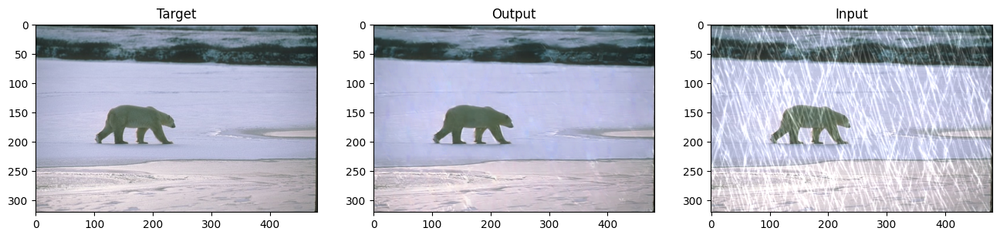

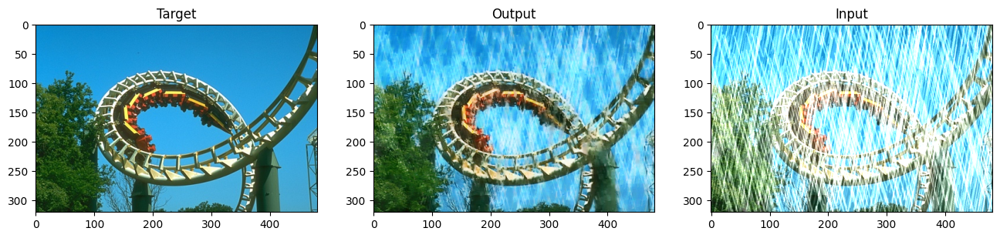

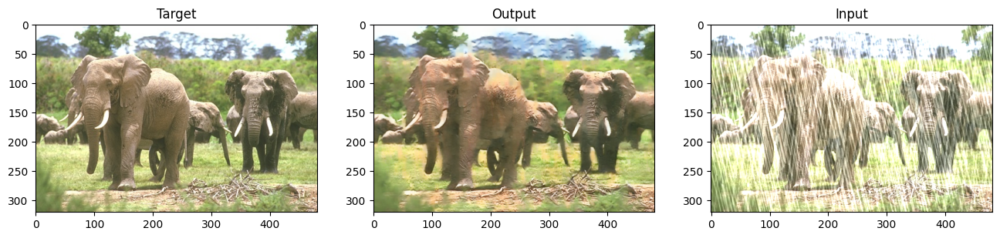

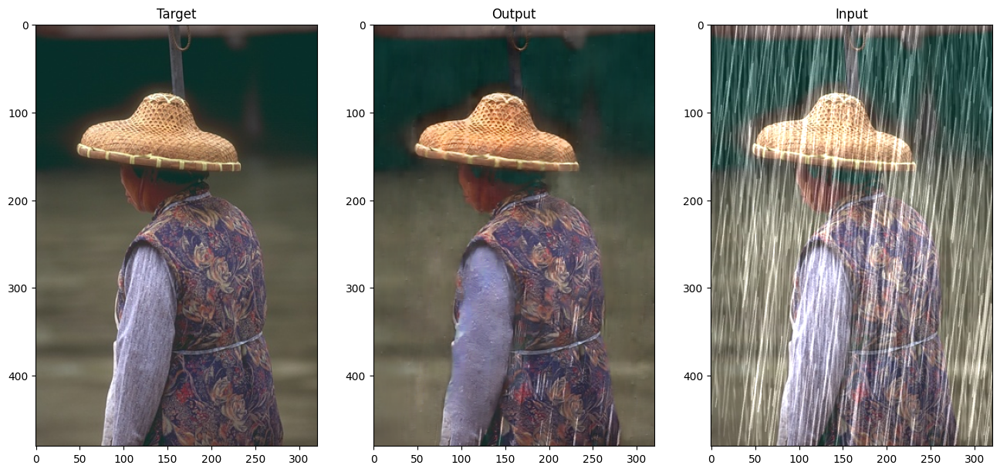

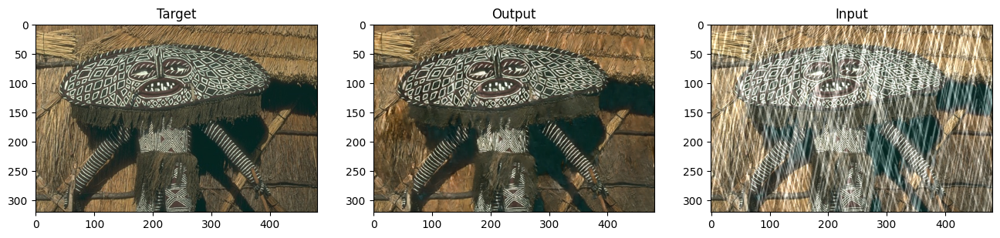

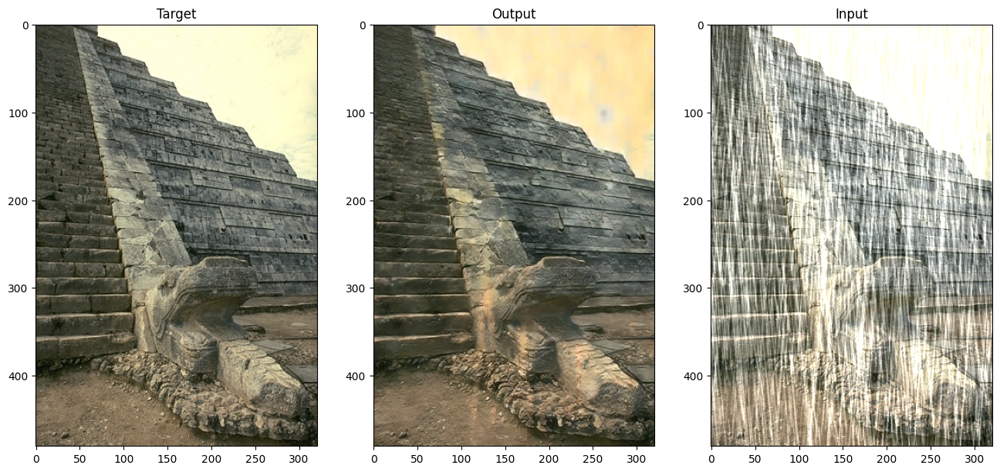

Average loss is 0.004694104203081224
Average PSNR is 24.109025577009447
Average SSIM is 0.8066897392272949
Validation time is 247.54234647750854


(np.float64(24.109025577009447), np.float32(0.80668974))

In [18]:
print("[TEST] Rain100H")
network_validation(CHECKPOINT_PATH, Rain100H_loader, len(Rain100H_loader), plot_img = True, display_all = False, save_img = False, save_dir = './Results/Rain100H')

[TEST] Rain100L


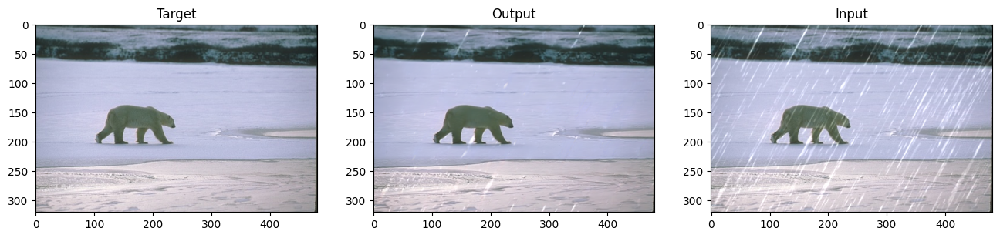

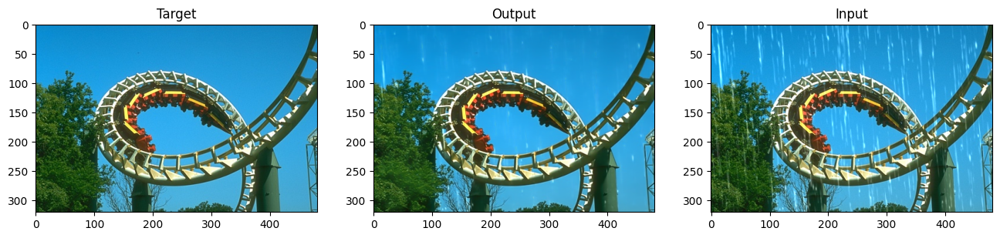

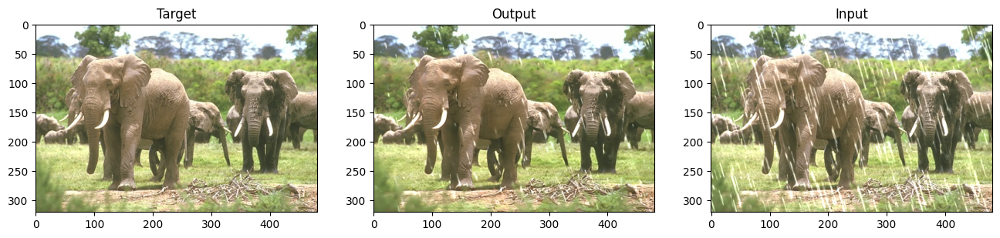

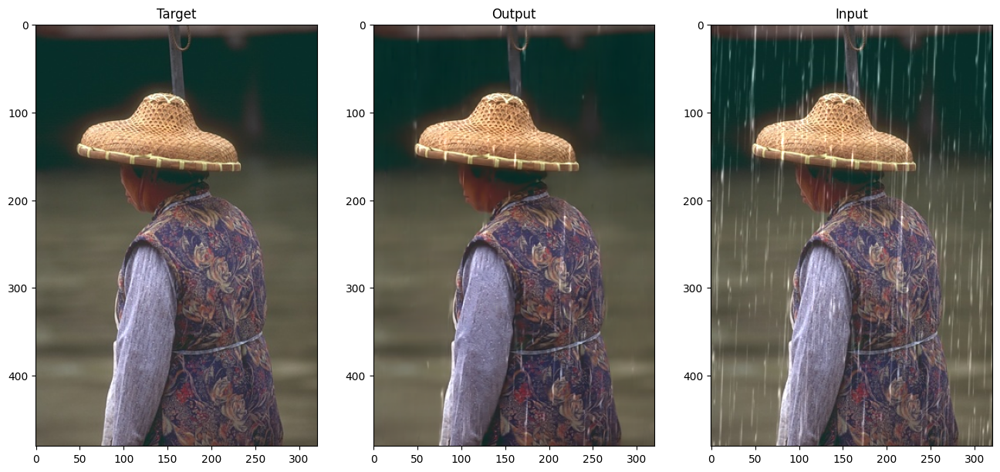

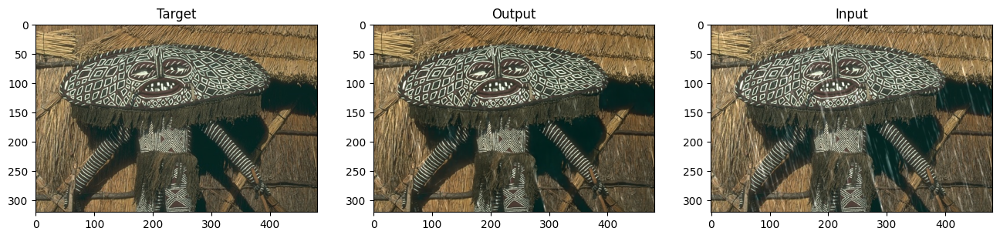

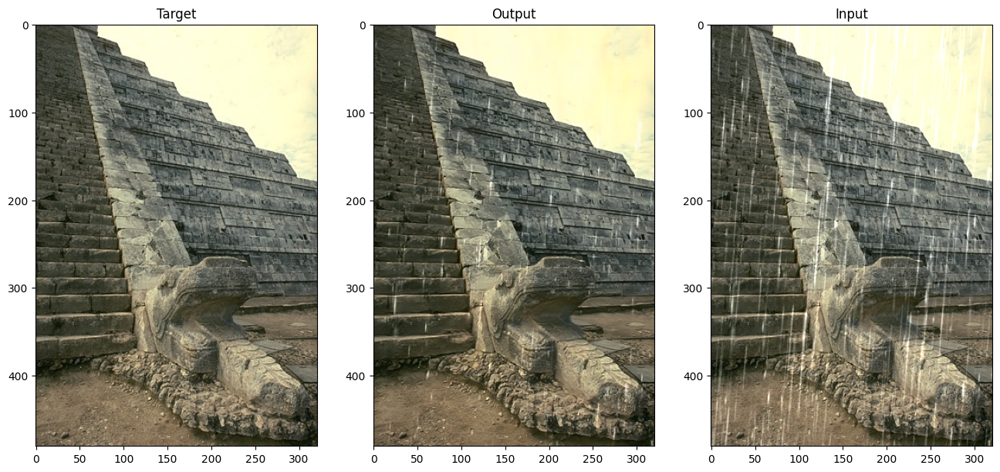

Average loss is 0.0015791898125462466
Average PSNR is 29.410583089142516
Average SSIM is 0.9278090000152588
Validation time is 245.05846405029297


(np.float64(29.410583089142516), np.float32(0.927809))

In [19]:
print("[TEST] Rain100L")
network_validation(CHECKPOINT_PATH, Rain100L_loader, len(Rain100L_loader), plot_img = True, display_all = False, save_img = False, save_dir = './Results/Rain100L')

[TEST] Rain14000


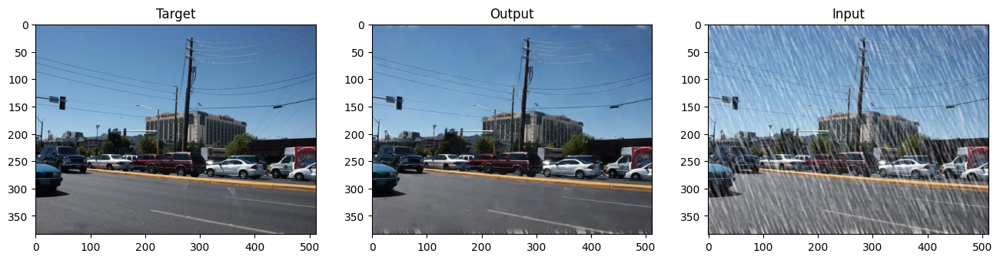

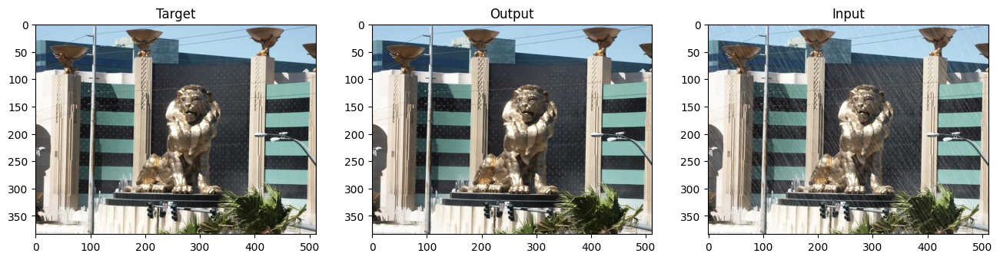

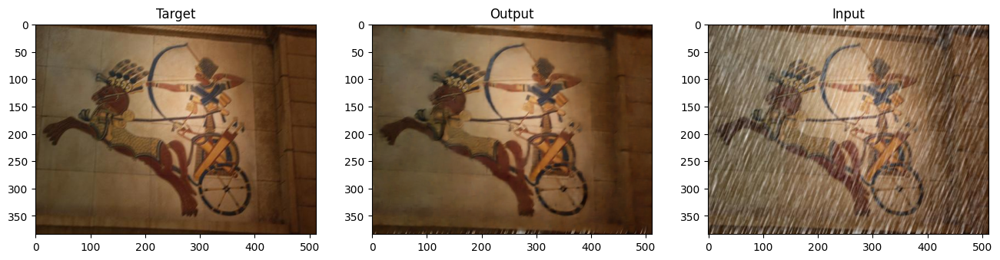

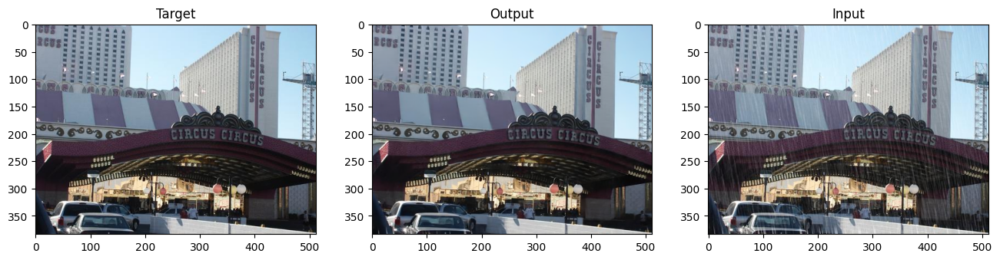

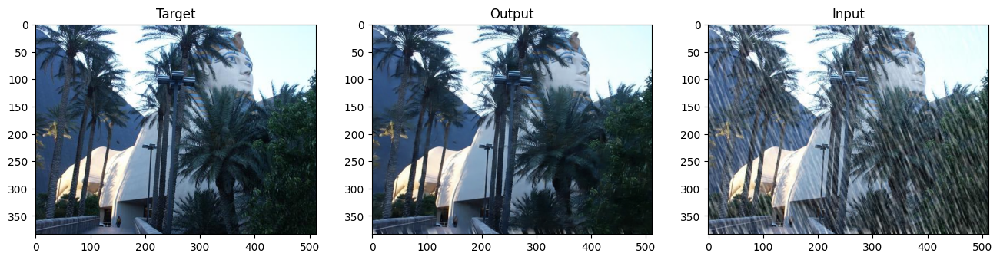

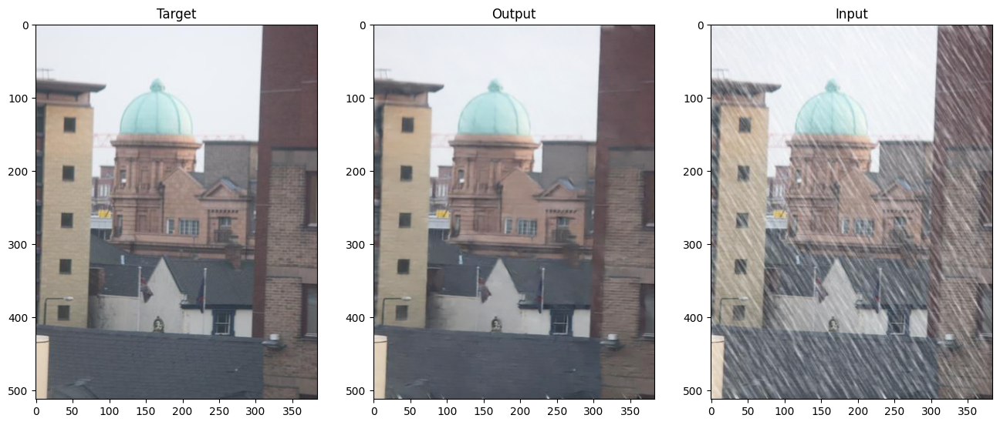

--- [WARNING] OOM at index 827 ---
Image size causing OOM: torch.Size([1, 3, 2562, 2562])
--- [WARNING] OOM at index 828 ---
Image size causing OOM: torch.Size([1, 3, 518, 518])
--- [WARNING] OOM at index 1021 ---
Image size causing OOM: torch.Size([1, 3, 3073, 3073])
Average loss is 0.0017325730781358568
Average PSNR is 29.511221364366683
Average SSIM is 0.8788949251174927
Validation time is 1939.716426372528


(np.float64(29.511221364366683), np.float32(0.8788949))

In [20]:
print("[TEST] Rain14000")
network_validation(CHECKPOINT_PATH, Rain14000_loader, len(Rain14000_loader), plot_img = True, display_all = False, save_img = False, save_dir = './Results/Rain14000')

[TEST] Test100


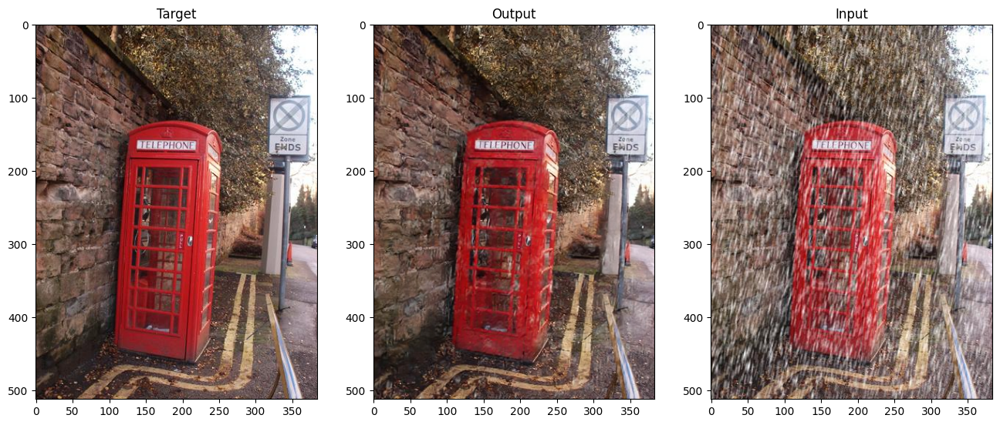

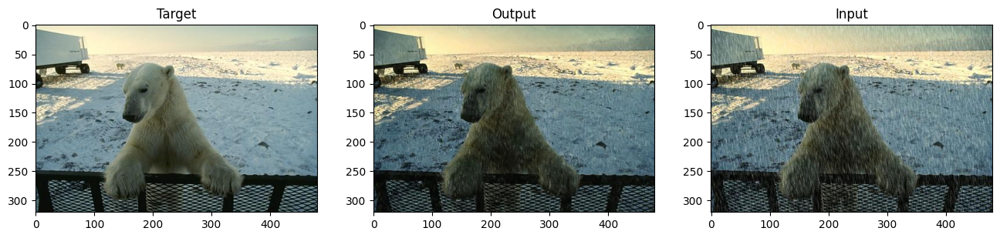

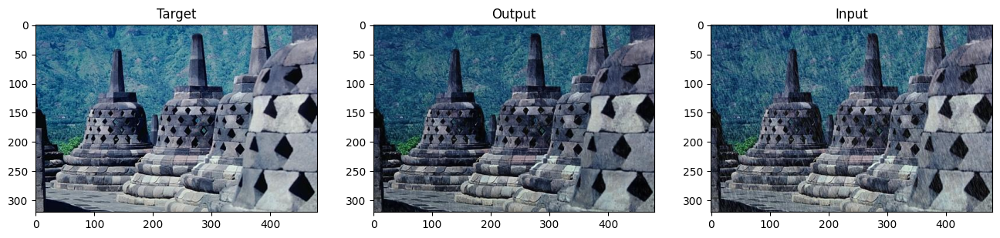

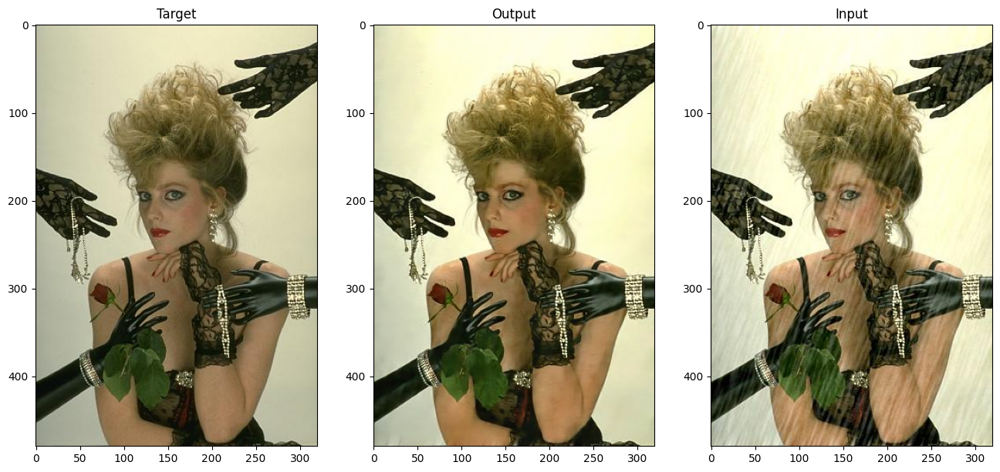

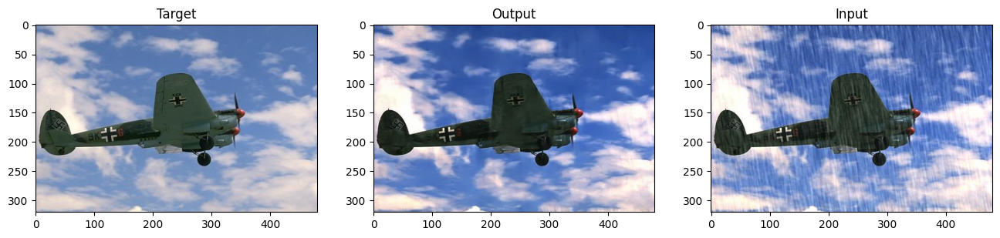

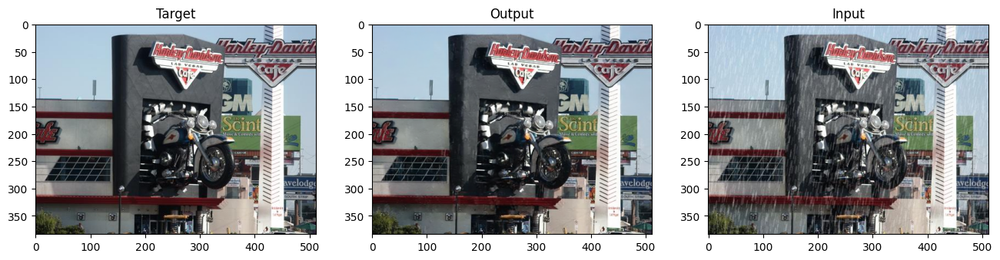

Average loss is 0.007634879638706999
Average PSNR is 22.86909399068254
Average SSIM is 0.7874414920806885
Validation time is 130.26055765151978


(np.float64(22.86909399068254), np.float32(0.7874415))

In [21]:
print("[TEST] Test100")
network_validation(CHECKPOINT_PATH, Test100_loader, len(Test100_loader), plot_img = True, display_all = False, save_img = False, save_dir = './Results/Test100')

[TEST] Test1200


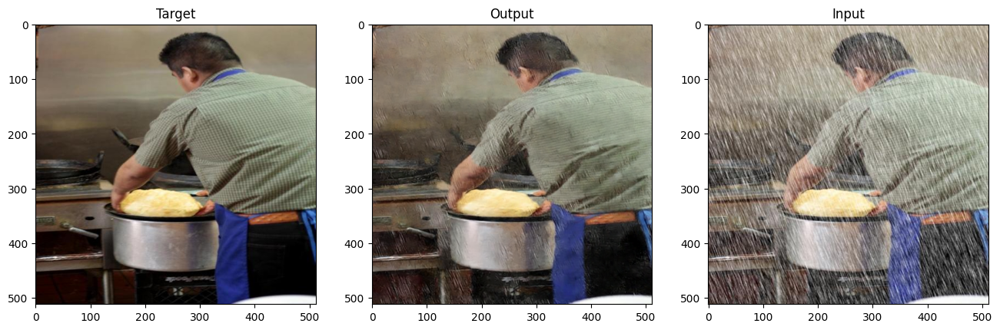

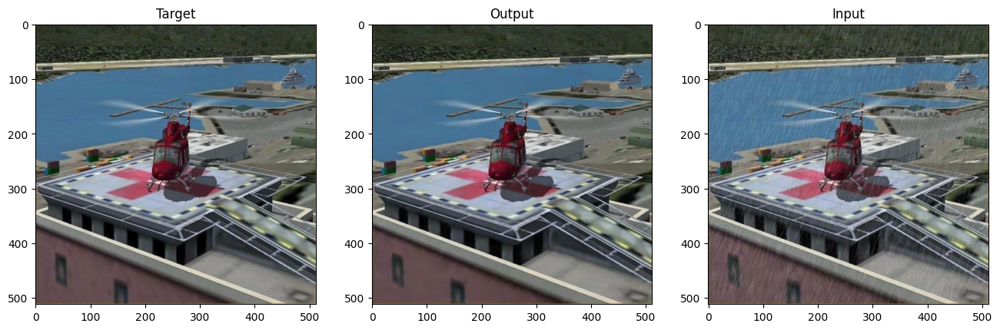

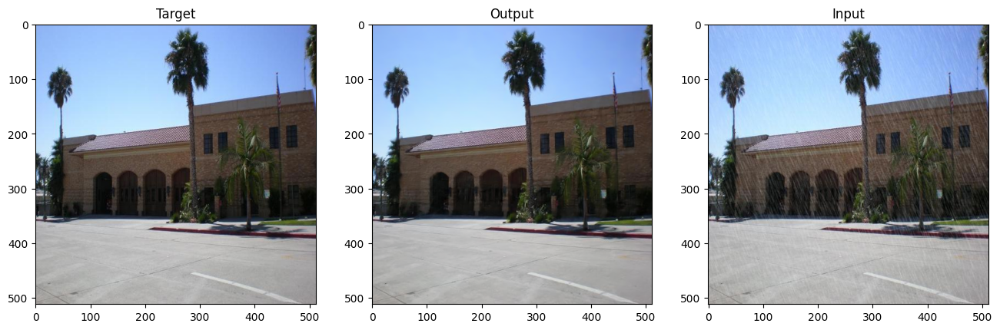

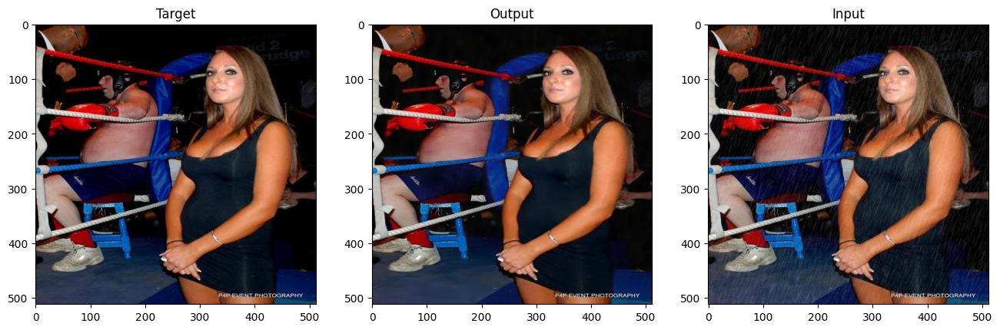

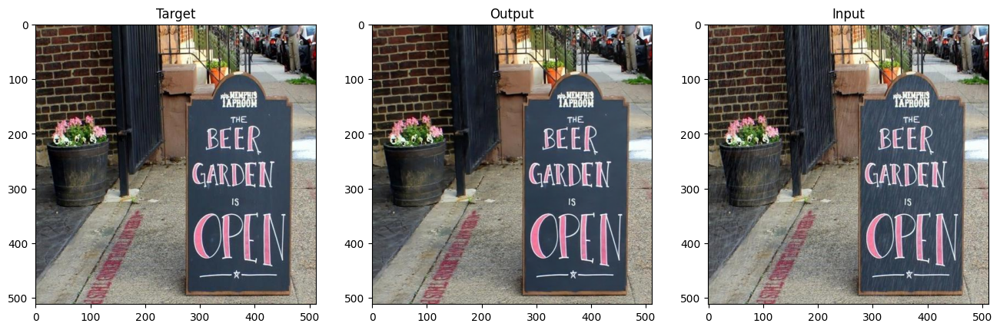

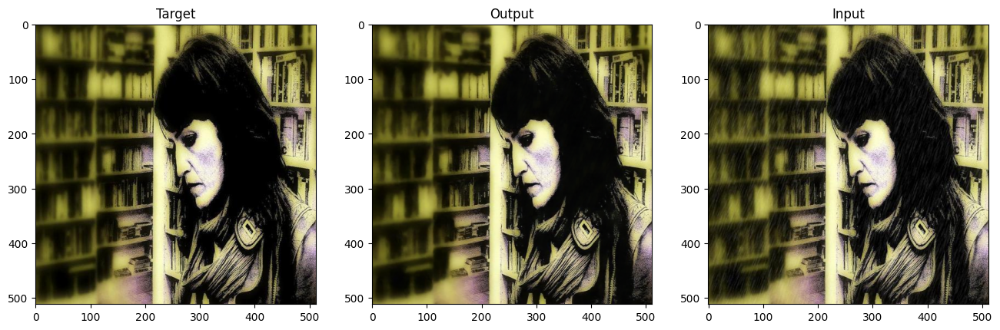

Average loss is 0.0018235405914250199
Average PSNR is 29.35498466510595
Average SSIM is 0.8592228293418884
Validation time is 1714.346286058426


(np.float64(29.35498466510595), np.float32(0.8592228))

In [22]:
print("[TEST] Test1200")
network_validation(CHECKPOINT_PATH, Test1200_loader, len(Test1200_loader), plot_img = True, display_all = False, save_img = False, save_dir = './Results/Test1200')

[TEST] Test2800


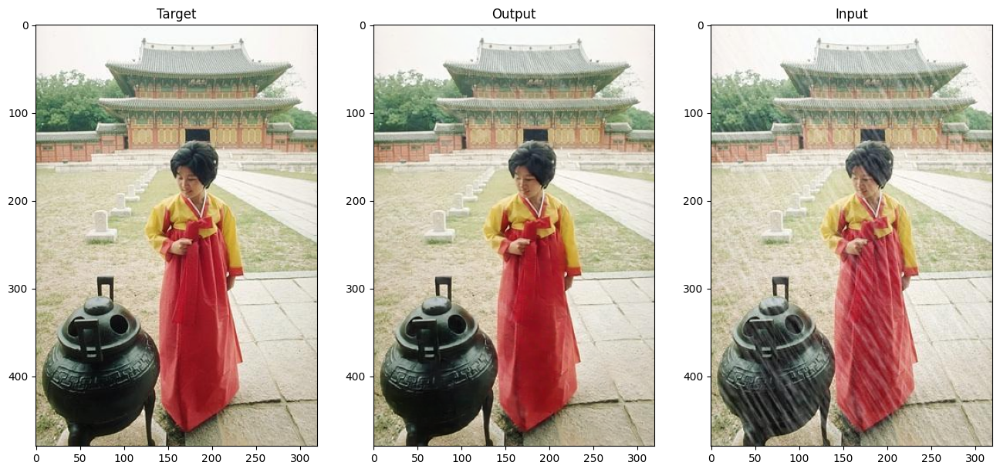

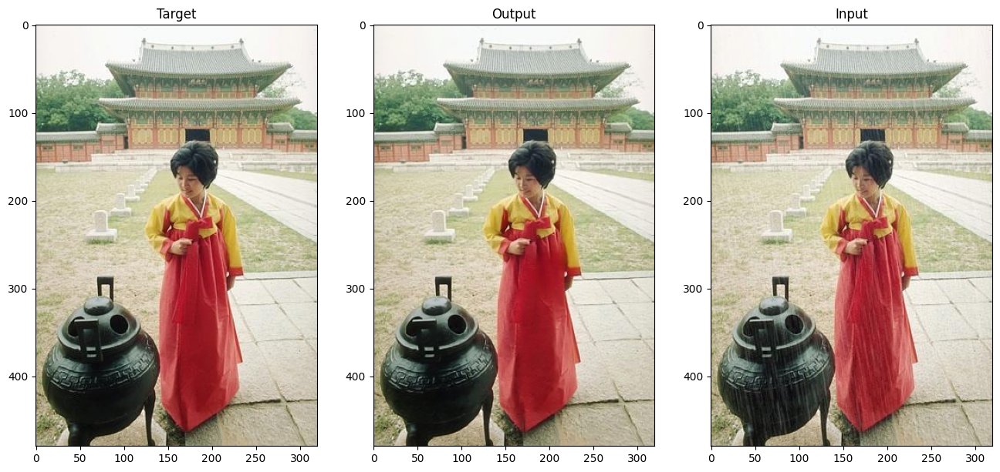

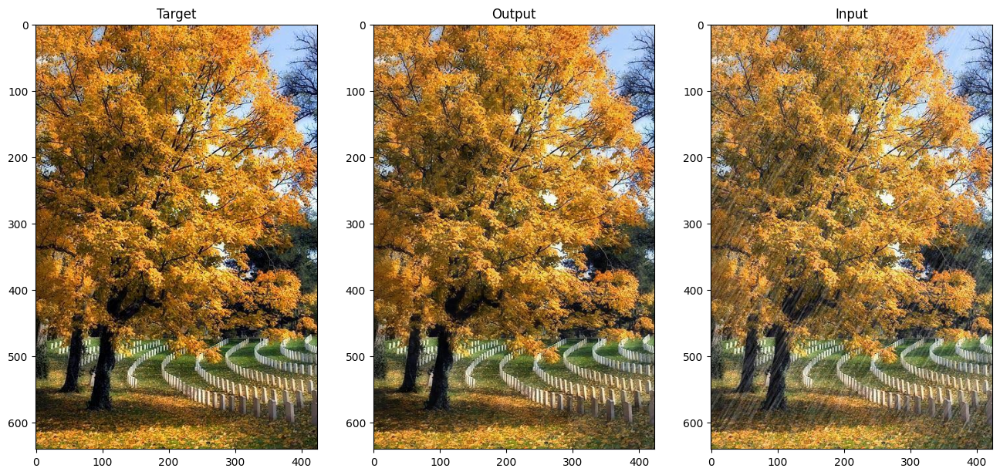

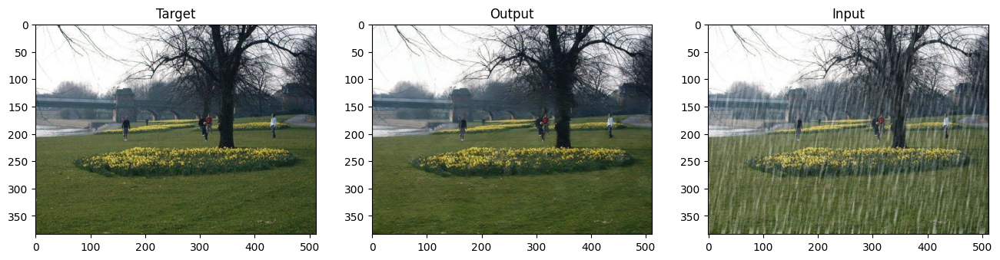

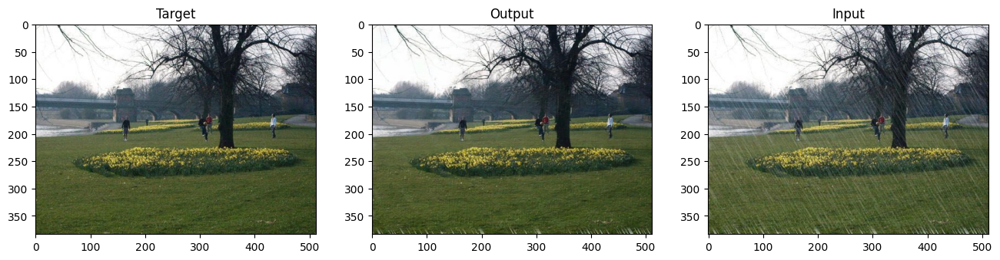

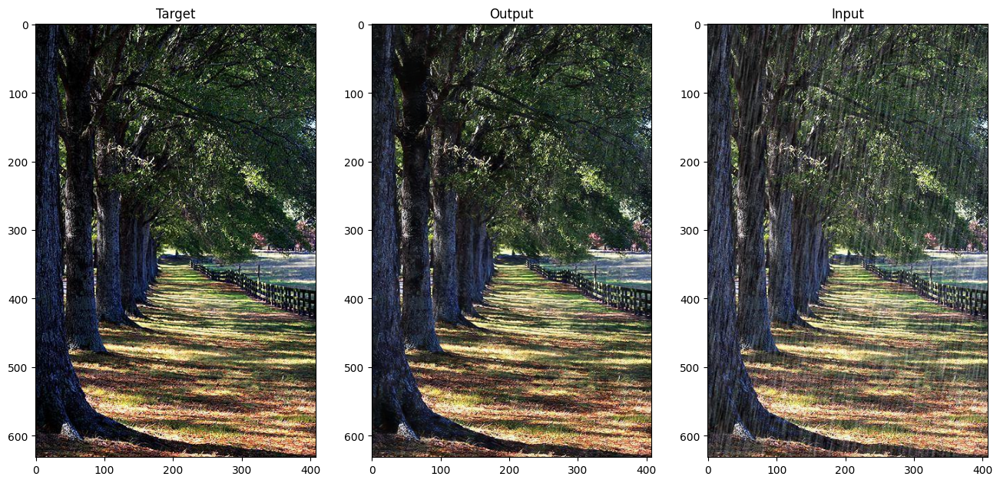

Average loss is 0.0011793568815950753
Average PSNR is 29.7358792328863
Average SSIM is 0.8803985714912415
Validation time is 4390.304131746292


(np.float64(29.7358792328863), np.float32(0.8803986))

In [23]:
print("[TEST] Test2800")
network_validation(CHECKPOINT_PATH, Test2800_loader, len(Test2800_loader), plot_img = True, display_all = False, save_img = False, save_dir = './Results/Test2800')